In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import cv2
import os, sys
import time
import glob


from PIL import Image
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.animation as animation
from itertools import chain, compress
from scipy.stats import chi2
from tqdm.notebook import tqdm
import plotly.express as px
import plotly.graph_objects as go

# import torch
# import torch.nn.functional as F

/home/groups/gracegao/conda_envs/deep_gnss/lib/python3.8/site-packages/xarray/backends/cfgrib_.py:27: UserWarning: Failed to load cfgrib - most likely there is a problem accessing the ecCodes library. Try `import cfgrib` to get the full error message
  warnings.warn(


In [2]:
import os, sys
# sys.path.append("/home/users/shubhgup/Codes/KITTI360_Processing/PyTorch-High-Res-Stereo-Depth-Estimation")
# sys.path.append("/home/users/shubhgup/Codes/KITTI360_Processing/stereo-transformer")
sys.path.append('../Stereo_VO')

# from highres_stereo import HighResStereo
# from highres_stereo.utils_highres import Config, CameraConfig, draw_disparity, draw_depth, QualityLevel
# from module.sttr import STTR
# from dataset.preprocess import normalization, compute_left_occ_region
# from utilities.misc import NestedTensor

from helpers import *

%load_ext autoreload
%autoreload 2

In [5]:
ids_r = sorted(glob.glob("/scratch/users/shubhgup/Right/*.png"))
ids_l = sorted(glob.glob("/scratch/users/shubhgup/Left/*.png"))

ids_disp_l = sorted(glob.glob("/scratch/users/shubhgup/Left/*_disp.jpeg"))
ids_dep_l = sorted(glob.glob("/scratch/users/shubhgup/Left/*_depth.npy"))

timestamp_r = np.array([int(_ids.split("/")[-1][:-4]) for _ids in ids_r])
timestamp_l = np.array([int(_ids.split("/")[-1][:-4]) for _ids in ids_l])

dist = np.abs(timestamp_l[:, None] - timestamp_r[None, :])

ids_r = [ids_r[_idx] for _idx in dist.argmin(axis=1)]

assert len(ids_l)==len(ids_r)

In [22]:
img_l = np.array(Image.open(ids_l[0]))
disp = np.array(Image.open(ids_disp_l[0]))
depth = np.load(ids_dep_l[0])
depth =  cv2.resize(depth[0, 0, :, :].T, disp.shape[:2], interpolation = cv2.INTER_AREA)

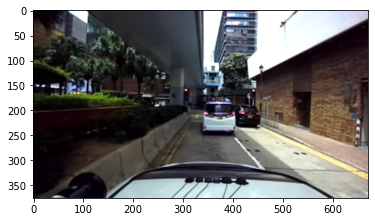

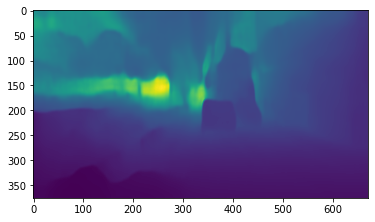

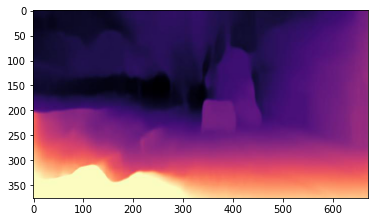

In [23]:
plt.imshow(img_l)
plt.show()
plt.imshow(depth.T)
plt.show()
plt.imshow(disp)

In [6]:
# # Default parameters
# args = type('', (), {})() # create empty args
# args.channel_dim = 128
# args.position_encoding='sine1d_rel'
# args.num_attn_layers=6
# args.nheads=8
# args.regression_head='ot'
# args.context_adjustment_layer='cal'
# args.cal_num_blocks=8
# args.cal_feat_dim=16
# args.cal_expansion_ratio=4

# model = STTR(args).cuda().eval()

# model_file_name  = "/oak/stanford/groups/gracegao/depth_pretrained_weights/kitti_finetuned_model.pth.tar"
# checkpoint = torch.load(model_file_name)
# pretrained_dict = checkpoint['state_dict']
# model.load_state_dict(pretrained_dict, strict=False)
# print("Pre-trained model successfully loaded.")

In [34]:
max_disparity = 16
window_size = 15

disparityEngine = cv2.StereoSGBM_create(
        minDisparity=0,
        numDisparities = max_disparity, # max_disp has to be dividable by 16 f. E. HH 192, 256
        blockSize=window_size,
        P1=8 * window_size ** 2,       # 8*number_of_image_channels*SADWindowSize*SADWindowSize
        P2=32 * window_size ** 2,      # 32*number_of_image_channels*SADWindowSize*SADWindowSize
#         disp12MaxDiff=1,
#         uniquenessRatio=15,
#         speckleWindowSize=0,
#         speckleRange=2,
#         preFilterCap=63,
        mode=cv2.STEREO_SGBM_MODE_HH
)

params_l = [672, 376, 264.9425, 264.79, 334.3975, 183.162, -0.0442856, 0.0133574, 0.0, 0.0]
H_l = np.linalg.inv(np.array([ 
     [9.9885234402635936e-01, 1.3591158885981787e-03, 4.7876378696062108e-02, -8.4994249456545504e-02],
     [-4.7864188349269129e-02, -7.9091258538426246e-03, 9.9882253939420773e-01, 6.6169337079143220e-01],
     [1.7361758877140372e-03, -9.9996779874765440e-01, -7.8349959194297103e-03, -3.0104266183335913e+00],
     [0., 0., 0., 1.] 
        ]))

params_r = [672, 376, 264.2125, 264.155, 341.635, 183.993, -0.0423469, 0.0115525, 0.0, 0.0]
H_r = np.linalg.inv(np.array([ 
    [9.9872871452749812e-01, 1.5287637777597791e-03, 5.0384696680271013e-02, 7.5332297629590136e-02],
    [-5.0367177375936031e-02, -9.8967686259809895e-03, 9.9868173179143760e-01, 6.8331281093016005e-01],
    [2.0253941424080261e-03, -9.9994985716888607e-01, -9.8071874914416046e-03, -3.0079627649520204e+00], 
    [0., 0., 0., 1.] 
        ]))

H_r = H_r @ np.linalg.inv(H_l)
H_l = np.eye(4)

cam_model = StereoPinholeCamera(params_l, H_l, params_r, H_r)

In [35]:
read_stereo_camera = lambda t: (np.array(Image.open(ids_l[t])), np.array(Image.open(ids_r[t])))

undistort_stereo = lambda a, b: (cv2.undistort(a, cam_model.pinhole_model_l.intrinsic_matrix(), cam_model.pinhole_model_l.d, None, cam_model.pinhole_model_l.intrinsic_matrix()), 
                                 cv2.undistort(b, cam_model.pinhole_model_r.intrinsic_matrix(), cam_model.pinhole_model_r.d, None, cam_model.pinhole_model_r.intrinsic_matrix()))

In [36]:
def draw_disparity(disparity_map):

    disparity_map = disparity_map.astype(np.uint8)
    norm_disparity_map = (255*((disparity_map-np.min(disparity_map))/(np.max(disparity_map) - np.min(disparity_map))))

    return cv2.applyColorMap(cv2.convertScaleAbs(norm_disparity_map,1), cv2.COLORMAP_JET)

In [37]:
t=2500
delta_t = 1

# Frame 1
new_frame_l, new_frame_r = read_stereo_camera(t)

# new_frame_l = cv2.resize(new_frame_l[:-100], (1242//4, 375//2), interpolation = cv2.INTER_AREA)
# new_frame_r = cv2.resize(new_frame_r[:-100], (1242//4, 375//2), interpolation = cv2.INTER_AREA)

# normalize
input_data = {'left': new_frame_l, 'right':new_frame_r}

In [38]:
disparity = gen_disparity(input_data['left'], input_data['right'], disparityEngine)

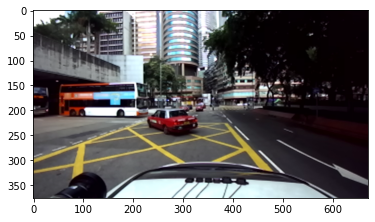

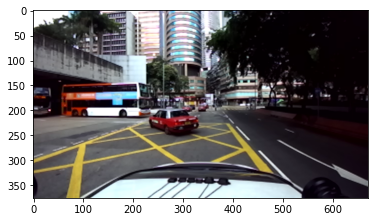

In [39]:
plt.imshow(new_frame_l)
plt.show()
plt.imshow(new_frame_r)

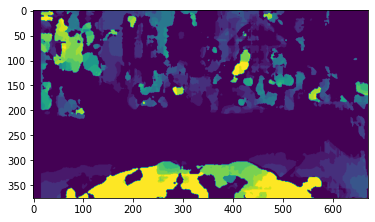

In [40]:
# visualize predicted disparity and occlusion map
plt.imshow(disparity)

In [41]:
h, w = new_frame_l.shape[:2]
f = cam_model.pinhole_model_l.fx
Q = np.float32([[1, 0, 0, -0.5*w],
                [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                [0, 0, 0,     -f], # so that y-axis looks up
                [0, 0, 1,      0]])

In [42]:
points = cv2.reprojectImageTo3D(disparity, Q)

In [45]:
plt_pts = points.reshape((-1, 3))

In [46]:
go.Figure(data=[go.Scatter3d(x=plt_pts[:, 0], y=plt_pts[:, 1], z=plt_pts[:, 2],
                                   mode='markers')]).show()